# Average Grayscale
A simple way to reduce an RGB image to grayscale is to calculate the average of its Red, Green, and Blue components, and use this average as the only component for its pixels. Let's see it working.

(629, 804, 3)

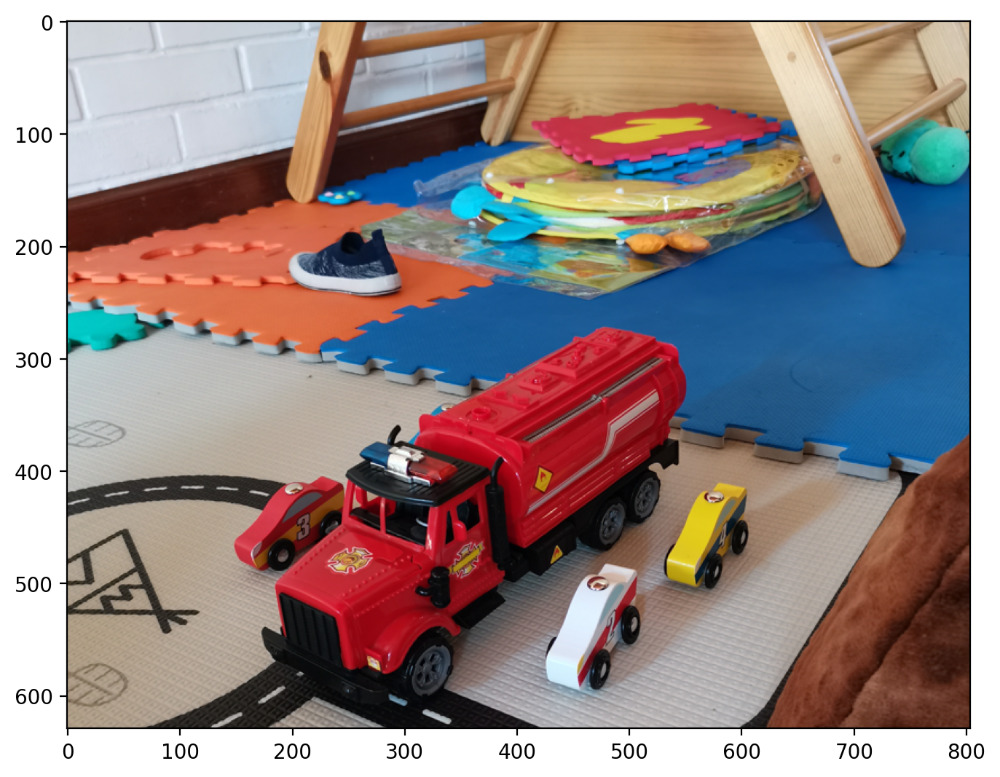

In [1]:
# Let's open a picture of a play space

import numpy as np
import matplotlib.pyplot as plt
%config InlineBackend.figure_formats = 'retina'
from EC_CV import *
from matplotlib import rcParams

plt.rcParams['figure.figsize'] = (8, 8)

toys = adapt_PNG(plt.imread('./image_for_COLOR_OPS/playspace.png'))
plt.imshow(toys)
np.shape(toys)

(629, 804)

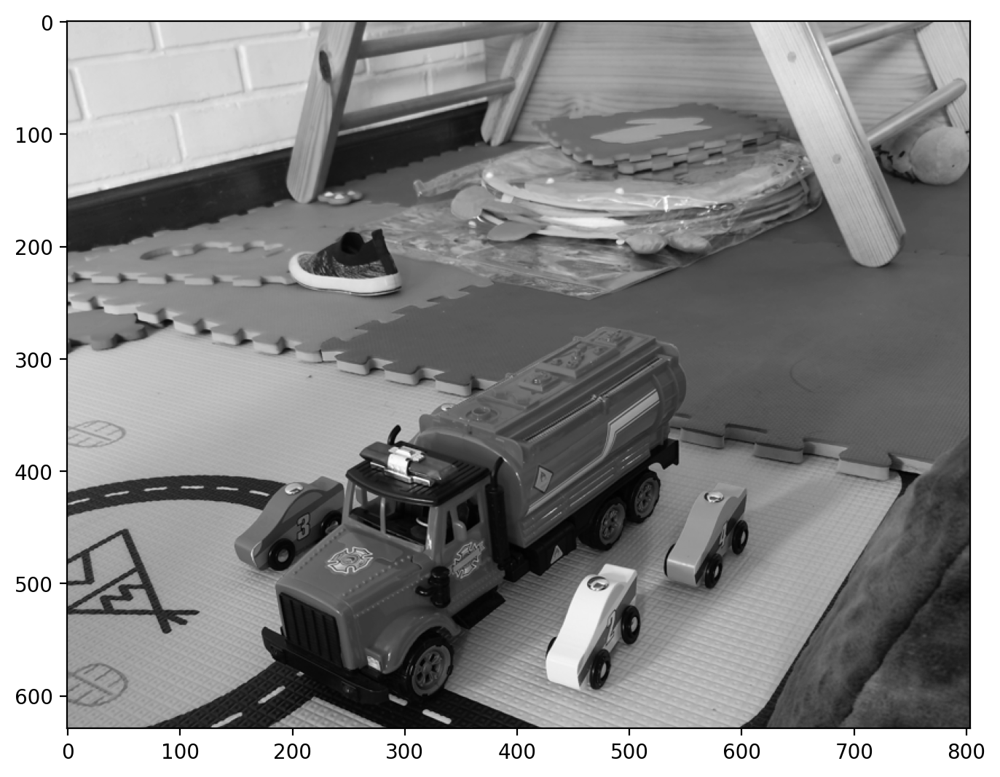

In [2]:
# Let's calculate the average for each pixel

def RGB_to_grayscale(RGB_pic):
    rows, cols, temp = np.shape(RGB_pic)
    gs = np.zeros((rows,cols))
    for i in range(rows):
        for j in range(cols):
            gs[i,j] = np.average(RGB_pic[i,j])
    return gs
        
toys_gs = RGB_to_grayscale(toys)
plt.imshow(toys_gs, cmap = 'gray')
np.shape(toys_gs)

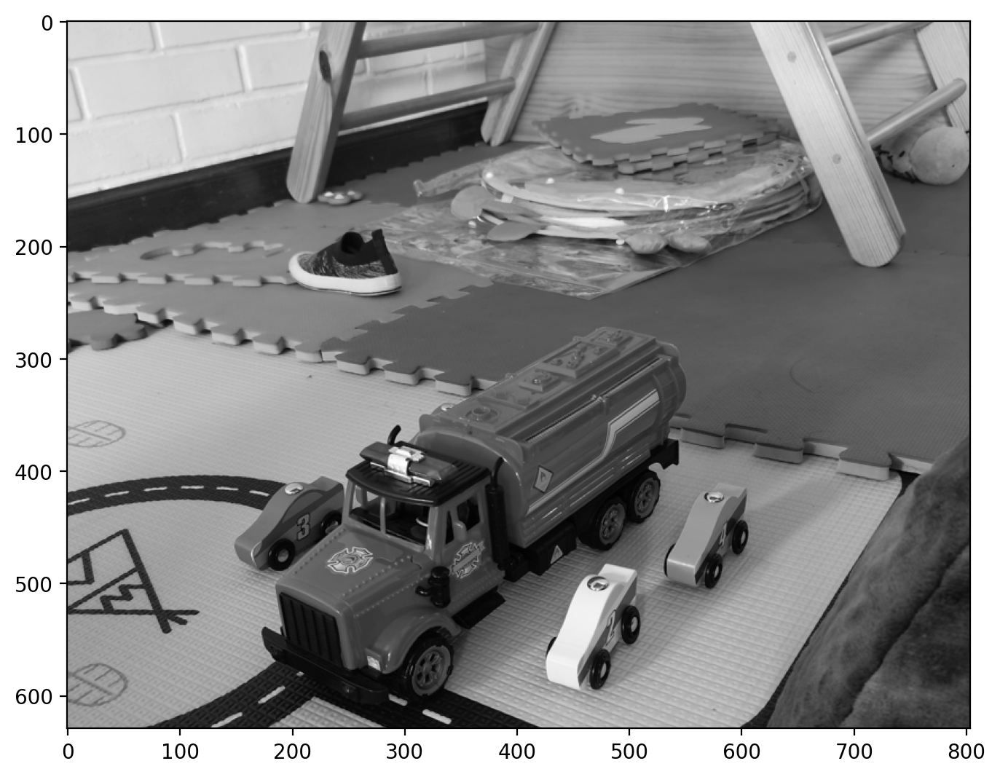

In [3]:
# Took too long? Let's try a compact expression

toys_gs = np.dot(toys[...,:3], [1/3,1/3,1/3])
plt.imshow(toys_gs, cmap = 'gray')

(3648, 5472, 3)

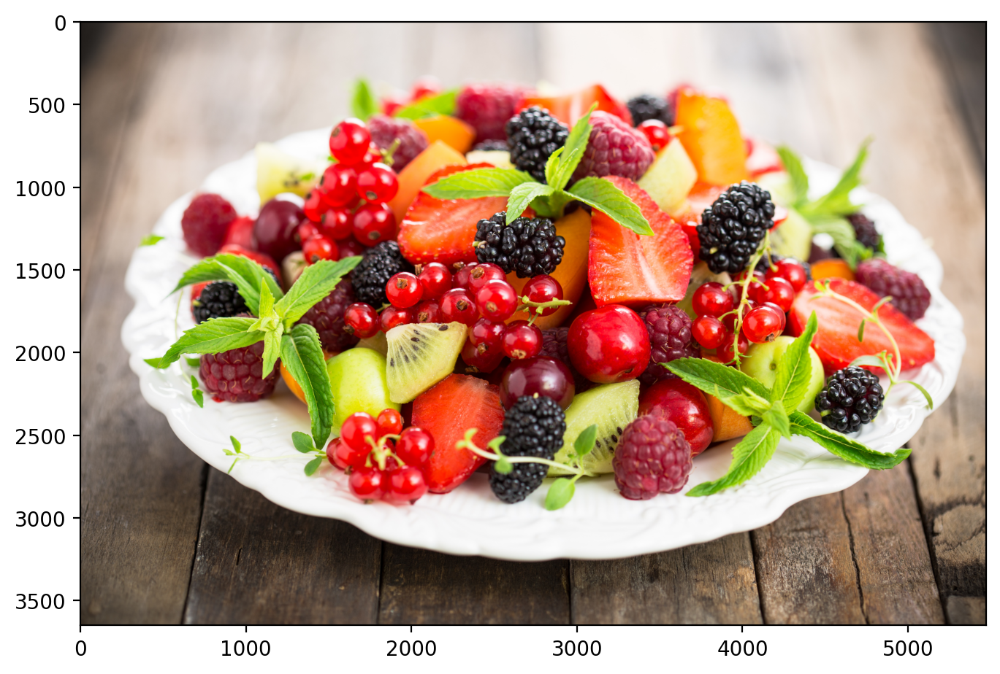

In [4]:
# Now let's try it on a big picture

fruit = plt.imread('./image_for_COLOR_OPS/fruit.jpg')
plt.imshow(fruit)
np.shape(fruit)

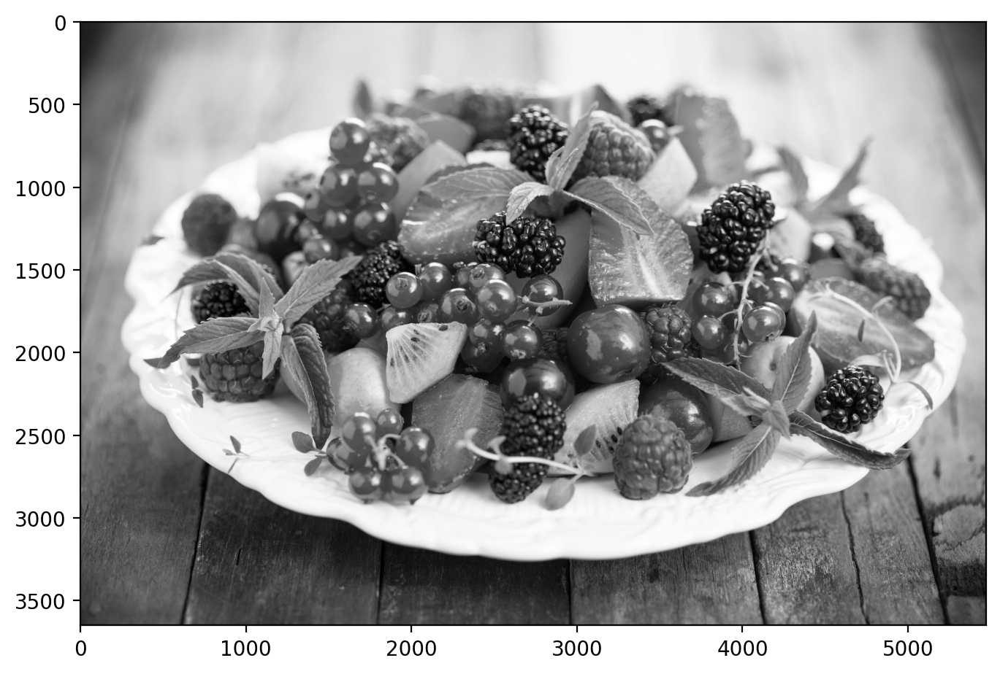

In [5]:
fruit_gs = np.dot(fruit[...,:3], [1/3,1/3,1/3])
plt.imshow(fruit_gs, cmap = 'gray')

# Weighted Grayscale
Average grayscale doesn't usually look very natural.
A more natural alternative consists in assigning different weights to Red, Green, and Blue, based on luminance or human perception.

A popular distribution is: 
* Red: 0.299
* Green: 0.587
* Blue: 0.114


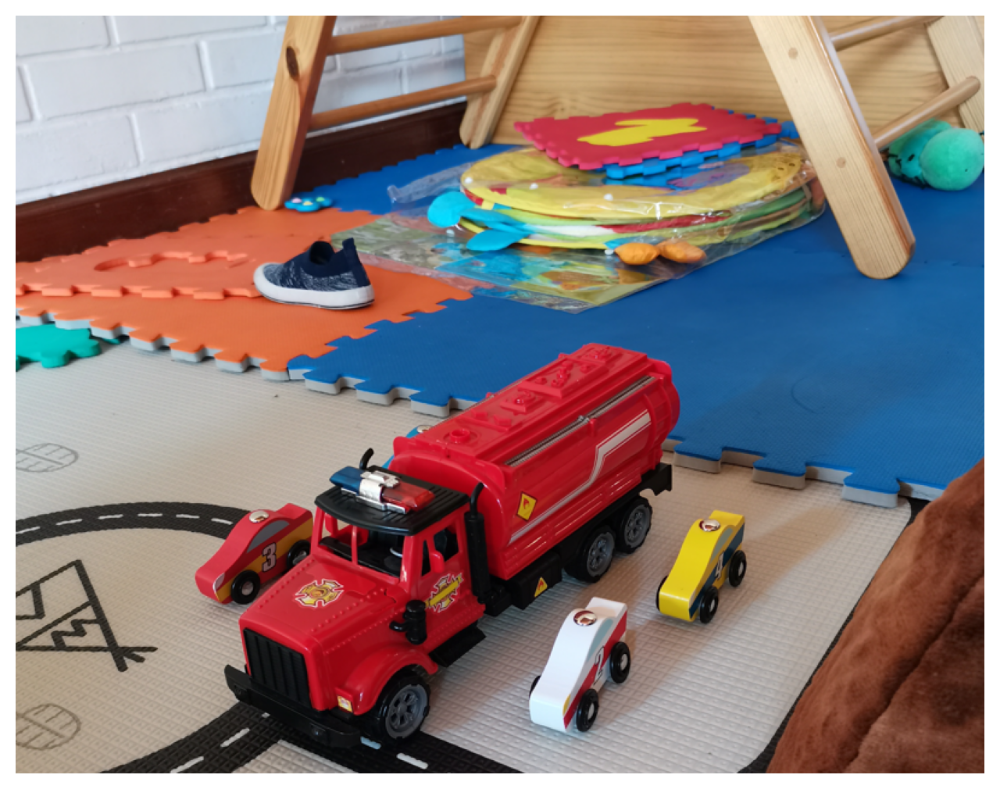

In [6]:
# Let's open the Playspace image again


plt.rcParams['figure.figsize'] = (8, 8)

toys = adapt_PNG(plt.imread('./image_for_COLOR_OPS/playspace.png'))
plt.axis("off")
plt.imshow(toys)

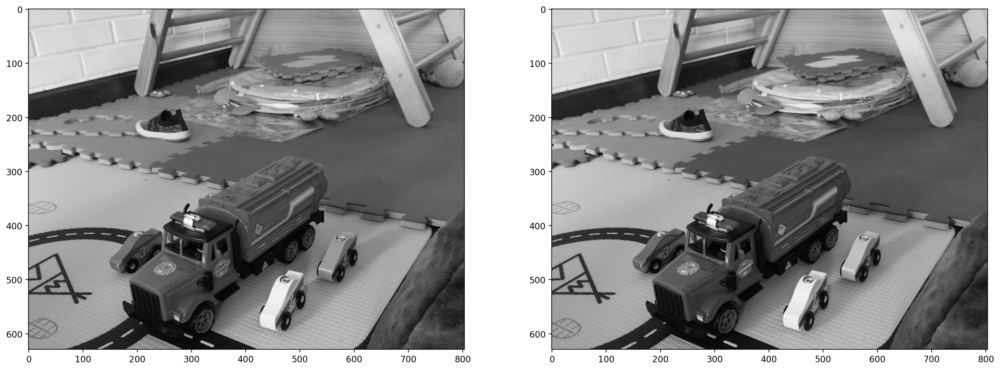

In [7]:
rcParams['figure.figsize'] = (20, 8)

# Calculate regular average and weighted average
toys_avg = np.dot(toys[...,:3], [1/3,1/3,1/3])
toys_wgt = np.dot(toys[...,:3], [0.299,0.587,0.114])

# display images
fig, ax = plt.subplots(1,2)
ax[0].imshow(toys_avg, cmap='gray')
ax[1].imshow(toys_wgt, cmap='gray')

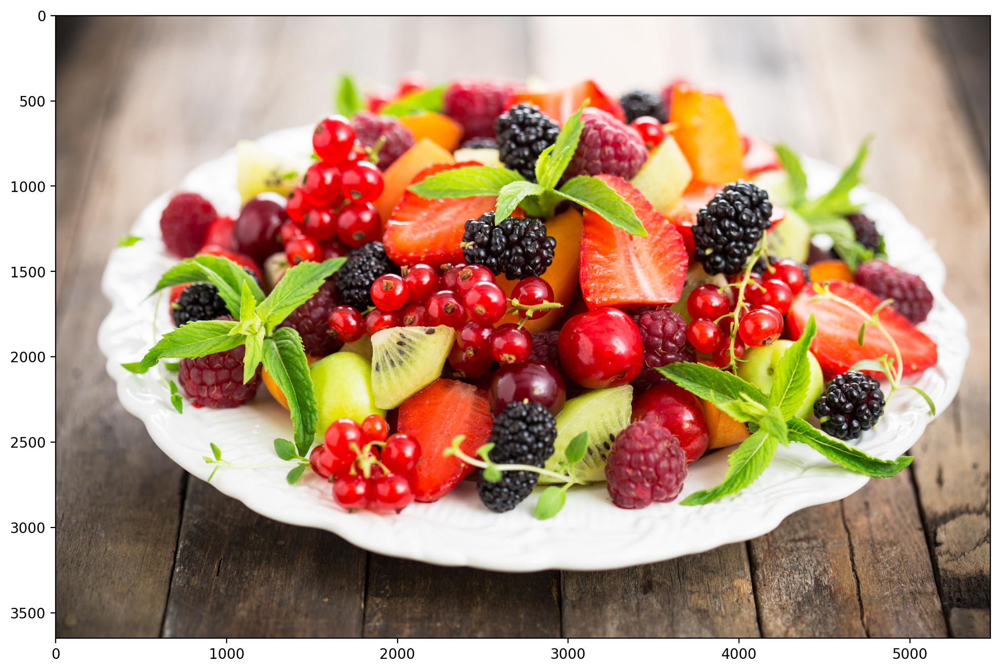

In [9]:
# Now let's try it on another picture

fruit = plt.imread('./image_for_COLOR_OPS/fruit.jpg')
plt.imshow(fruit)

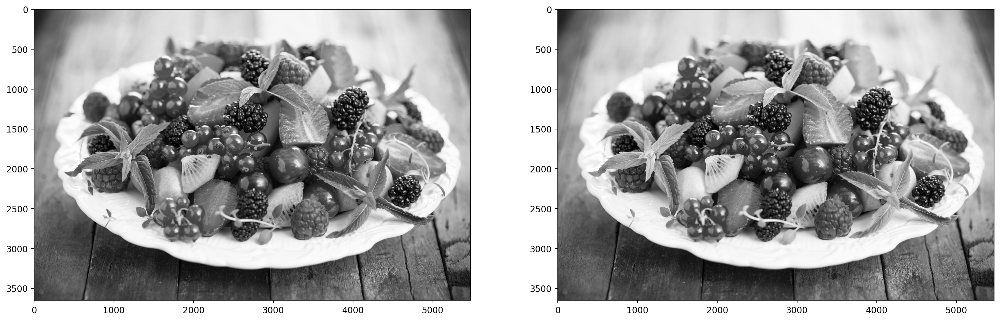

In [10]:
fruit_avg = np.dot(fruit[...,:3], [1/3,1/3,1/3])
fruit_wgt = np.dot(fruit[...,:3], [0.299,0.587,0.114])

# figure size in inches
rcParams['figure.figsize'] = 20, 8

# display images
fig, ax = plt.subplots(1,2)
ax[0].imshow(fruit_avg, cmap='gray')
ax[1].imshow(fruit_wgt, cmap='gray')

# Converting Grayscale to Black and White
Sometimes you need to represent color images as absolute black and white. Binary picture files requite much less storage space, as each pixel can be represented with a single bit.


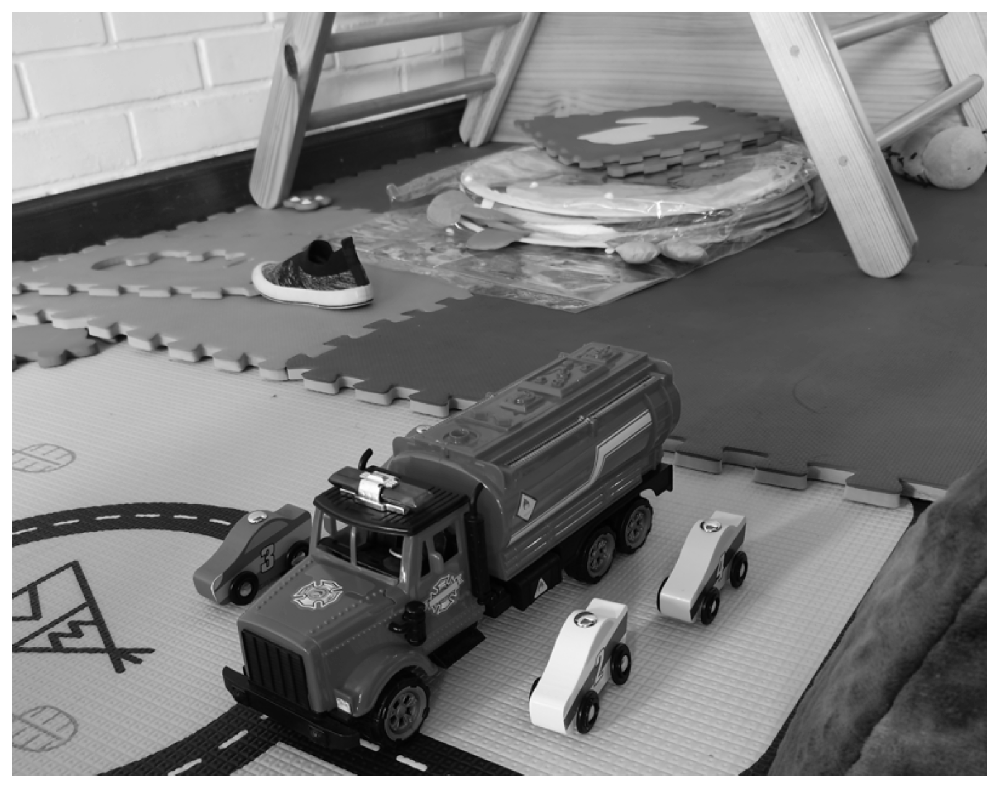

In [11]:
# Let's work with the play space picture


rcParams['figure.figsize'] = 20,8

toys = adapt_PNG(plt.imread('./image_for_COLOR_OPS/playspace.png'))
toys_wgt = np.dot(toys[...,:3], [0.299,0.587,0.114])
plt.axis("off")
plt.imshow(toys_wgt,cmap='gray')

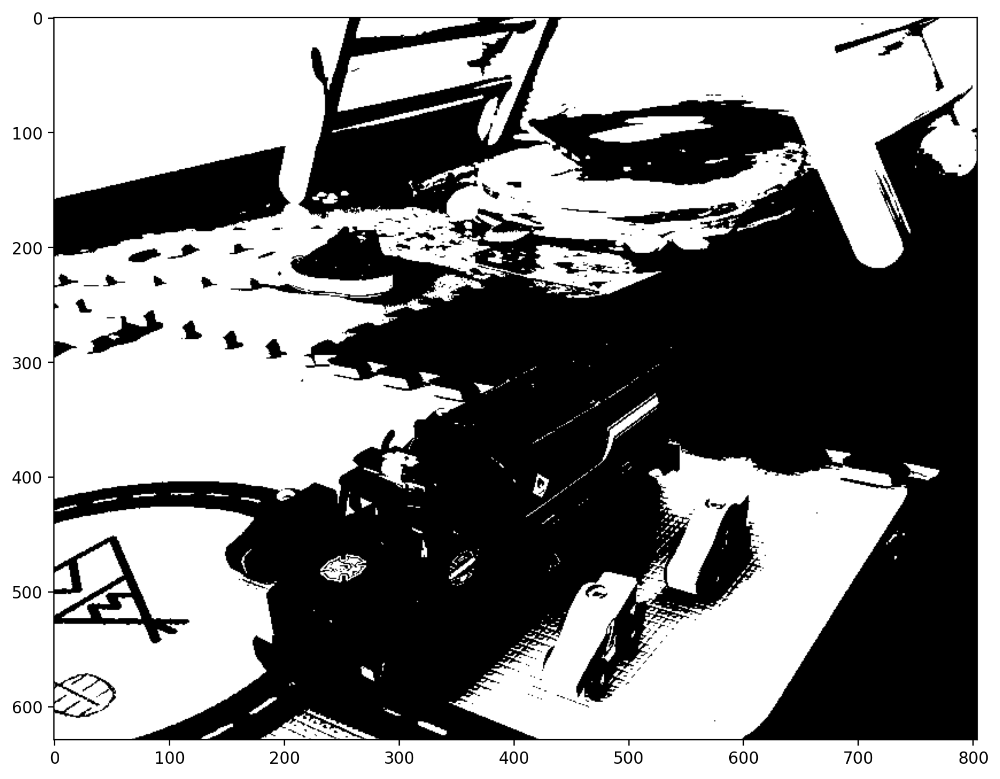

In [12]:
# Let's turn each pixel to total black or total white.
# We'll use the grayscale_to_BW() function from EC_CV

rcParams['figure.figsize'] = 20,8

toys_BW = grayscale_to_BW(toys_wgt,127)
plt.imshow(toys_BW, cmap = 'gray')

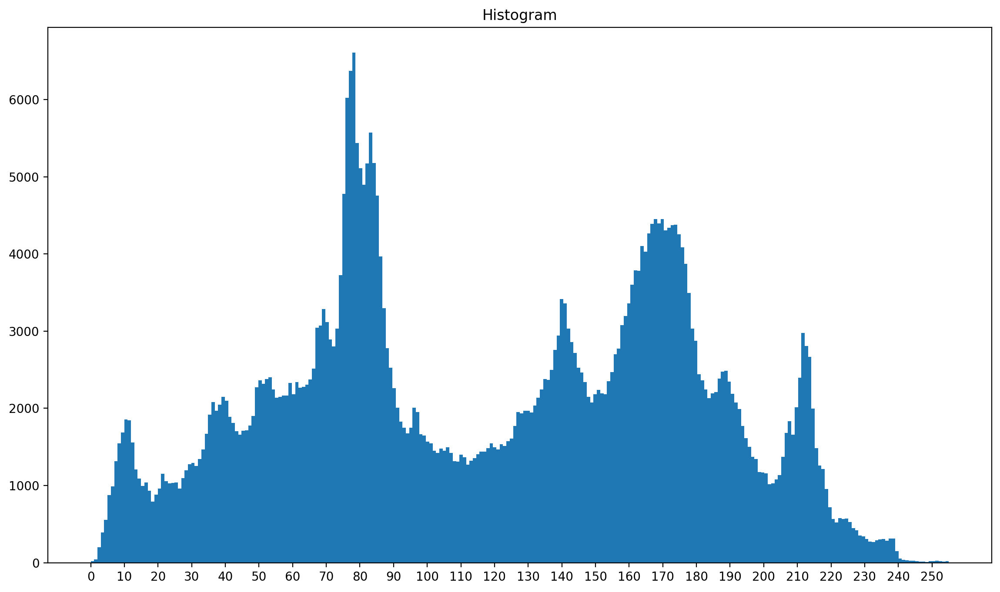

In [13]:
# Let's see a histogram of the grayscale image

rcParams['figure.figsize'] = (14,8)
plt.hist(toys_wgt.ravel(),256,[0,255])
plt.title('Histogram')
plt.xticks(np.arange(0, 255, 10))
plt.show()

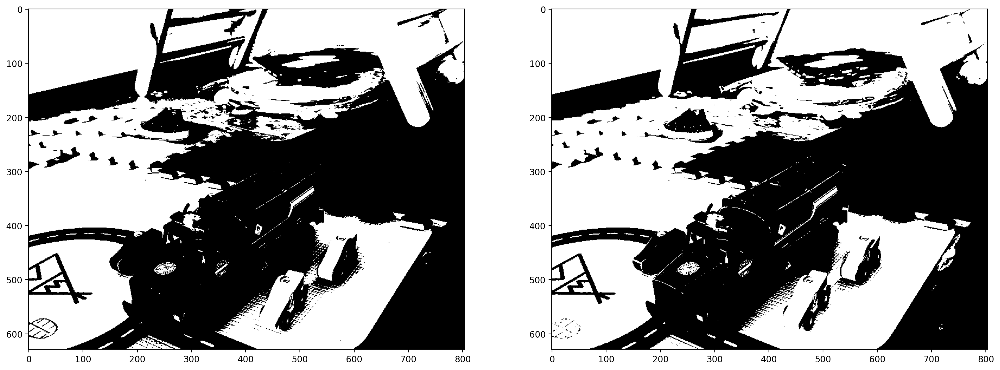

In [14]:
# Now let's create a new Black and White image with a threshold of 115
rcParams['figure.figsize'] = (20,8)

toys_BW2 = grayscale_to_BW(toys_wgt,115)

fig, ax = plt.subplots(1,2)
ax[0].imshow(toys_BW, cmap='gray')
ax[1].imshow(toys_BW2, cmap='gray')


# Adaptive Thresholding

Some images that contain segments with differces in lighting may be tricky to turn into a black and white representation because a single threshold won't work for the whole picture. There are several methods to perform adaptive thresholding.

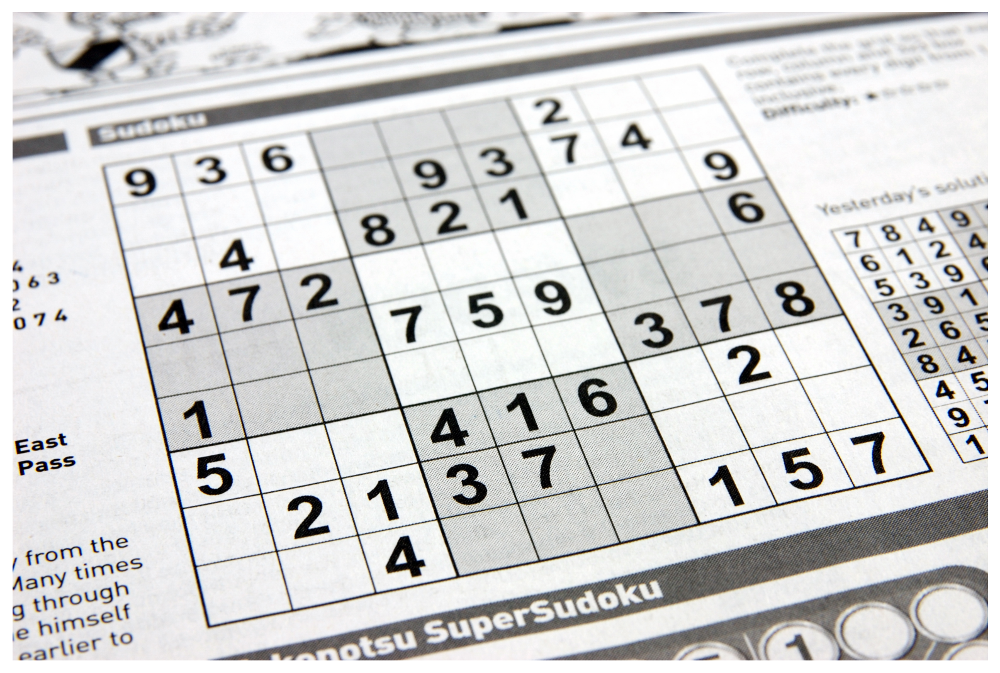

In [25]:
# First let's open a color picture
import cv2
%config InlineBackend.figure_formats = 'retina'
from matplotlib import rcParams
from EC_CV import *

rcParams['figure.figsize'] = 10,14
img = plt.imread('./image_for_COLOR_OPS/sudoku.jpg')
plt.axis("off")
plt.imshow(img)

(2000, 3008)


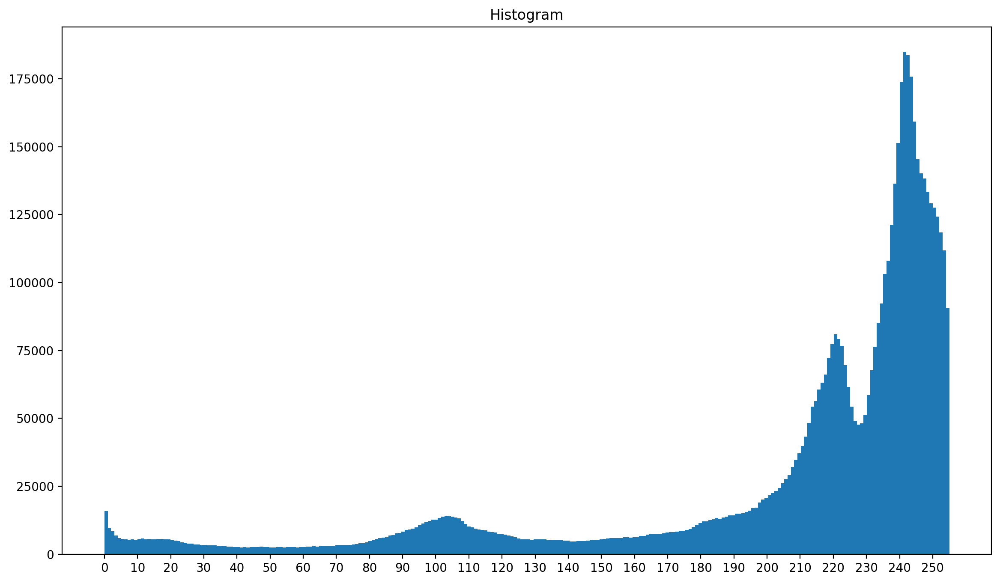

In [26]:
# Let's see a histogram of the grayscale image
img = np.dot(img[...,:3], [0.299,0.587,0.114])
print(np.shape(img))

rcParams['figure.figsize'] = (14,8)
plt.hist(img.ravel(),256,[0,255])
plt.title('Histogram')
plt.xticks(np.arange(0, 255, 10))
plt.show()

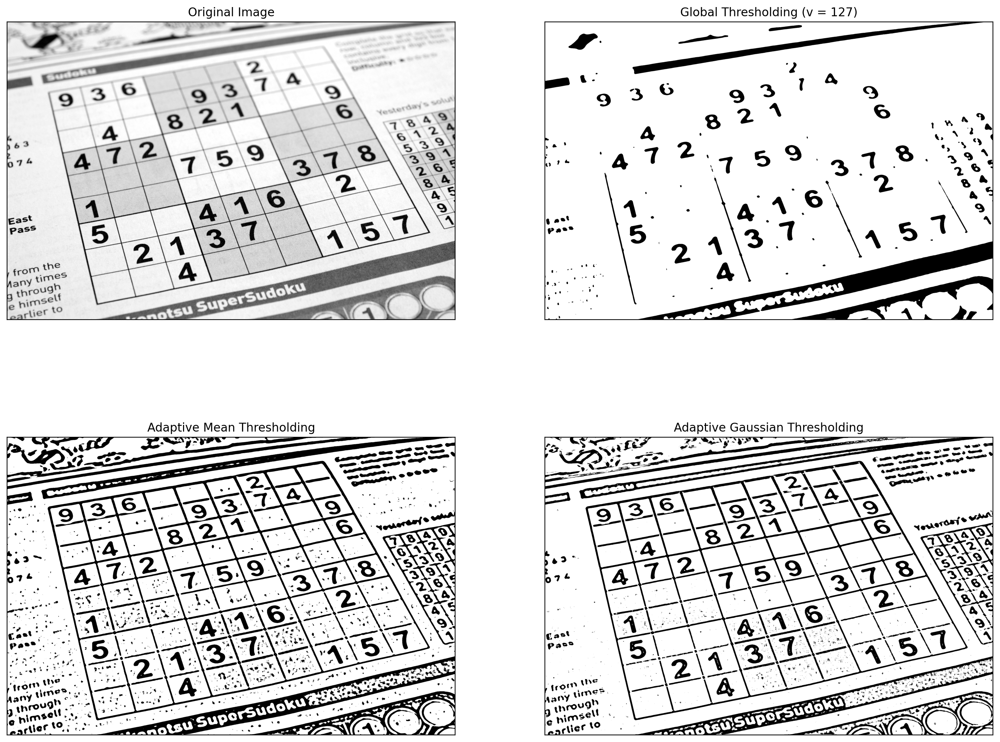

In [27]:
# Now let's see a piece of code from OpenCV's website where two adaptive
# threshold methods are used: 
#                     - Adaptive Mean Thresholding
#                     - Adaptive Gaussian Thresholding. 
rcParams['figure.figsize'] = (18,14)
threshold = 127 # Also try it with 215 and 225
img0 = cv2.imread('./image_for_COLOR_OPS/sudoku.jpg',0)
img = cv2.medianBlur(img0,17)
ret,th1 = cv2.threshold(img,threshold,255,cv2.THRESH_BINARY)
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,33,2)
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,33,2)
titles = ['Original Image', 'Global Thresholding (v = '+str(threshold)+')',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img0, th1, th2, th3]
for i in range(4):
    plt.subplot(2,2,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

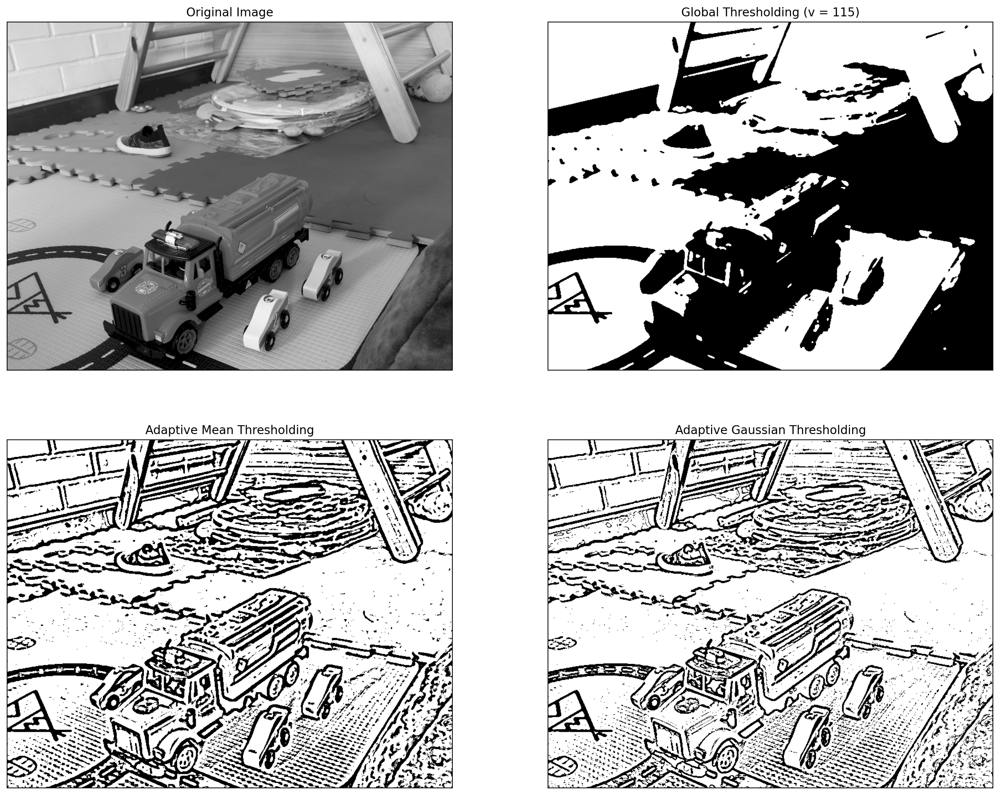

In [28]:
# Now let's see it with the play space image
rcParams['figure.figsize'] = (18,14)
threshold = 115
img0 = cv2.imread('./image_for_COLOR_OPS/playspace.png',0)
img = cv2.medianBlur(img0,5)
ret,th1 = cv2.threshold(img,threshold,255,cv2.THRESH_BINARY)
th2 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_MEAN_C,cv2.THRESH_BINARY,11,2)
th3 = cv2.adaptiveThreshold(img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,11,2)
titles = ['Original Image', 'Global Thresholding (v = '+str(threshold)+')',
            'Adaptive Mean Thresholding', 'Adaptive Gaussian Thresholding']
images = [img0, th1, th2, th3]
for i in range(4):
    plt.subplot(2,2,i+1),plt.imshow(images[i],'gray')
    plt.title(titles[i])
    plt.xticks([]),plt.yticks([])
plt.show()

# Removing Color

Let's convert a color picture into black and white.

In [29]:
# Don't modify this cell, just run it. 

rcParams['figure.figsize'] = (10, 8)


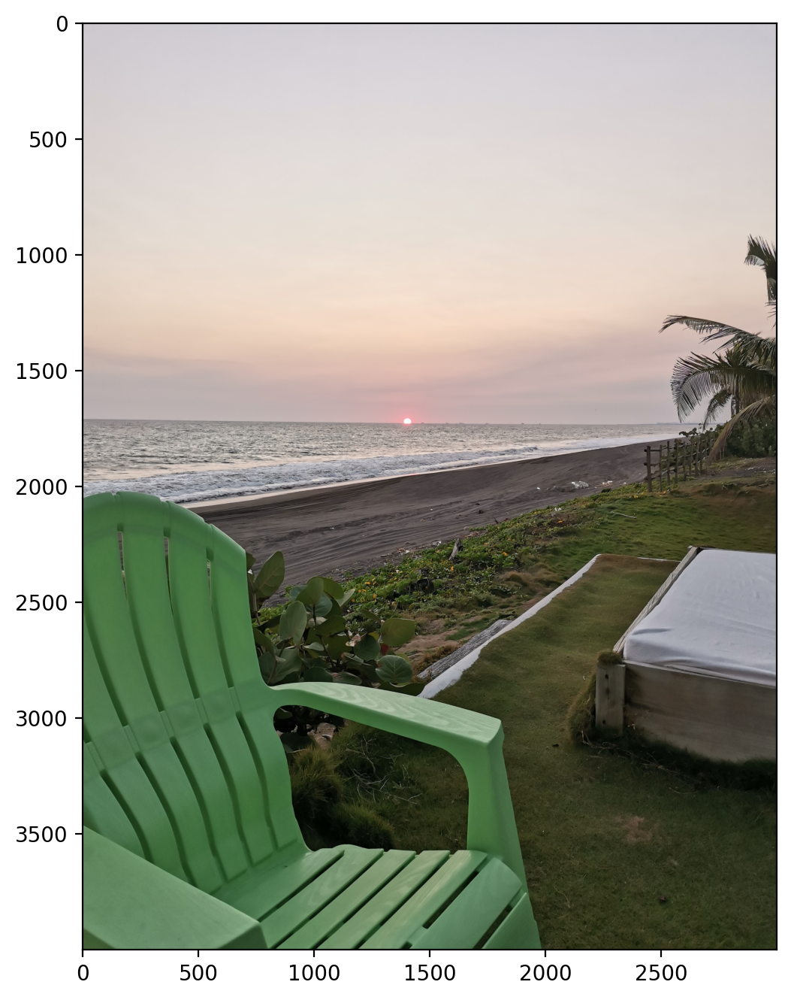

In [30]:
img_c  = plt.imread('./image_for_COLOR_OPS/sunset.jpg')
plt.imshow(img_c)

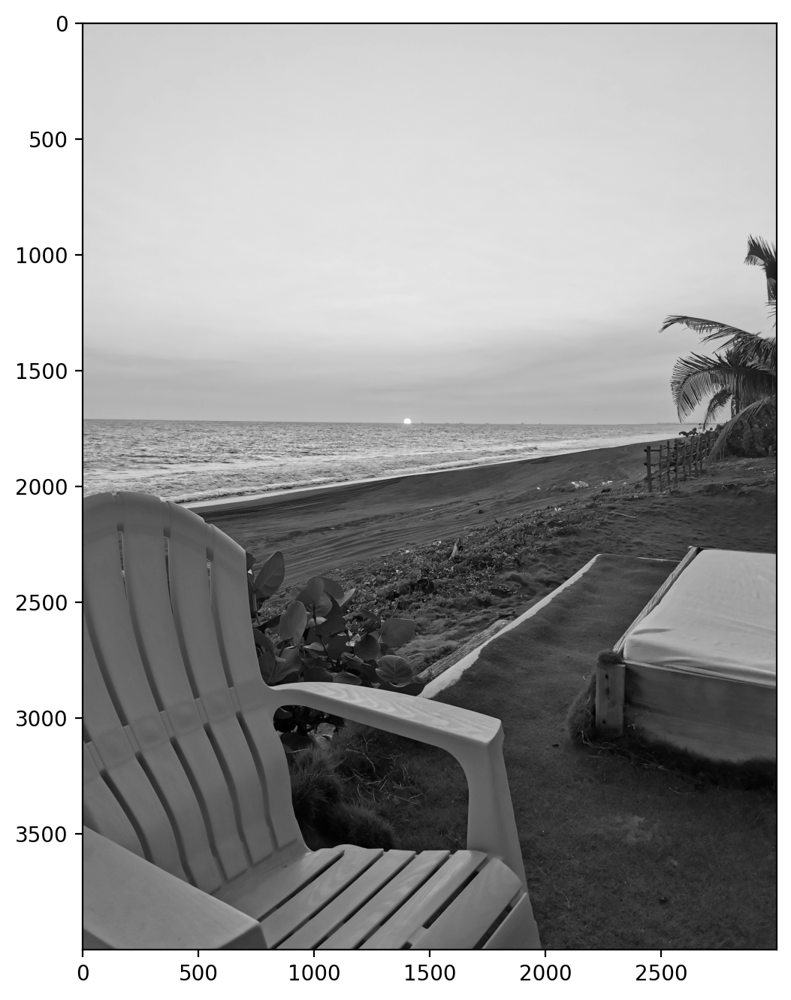

In [35]:
img_gs = np.dot(img_c[...,:3], [0.299,0.587,0.114])
plt.imshow(img_gs, cmap='gray')

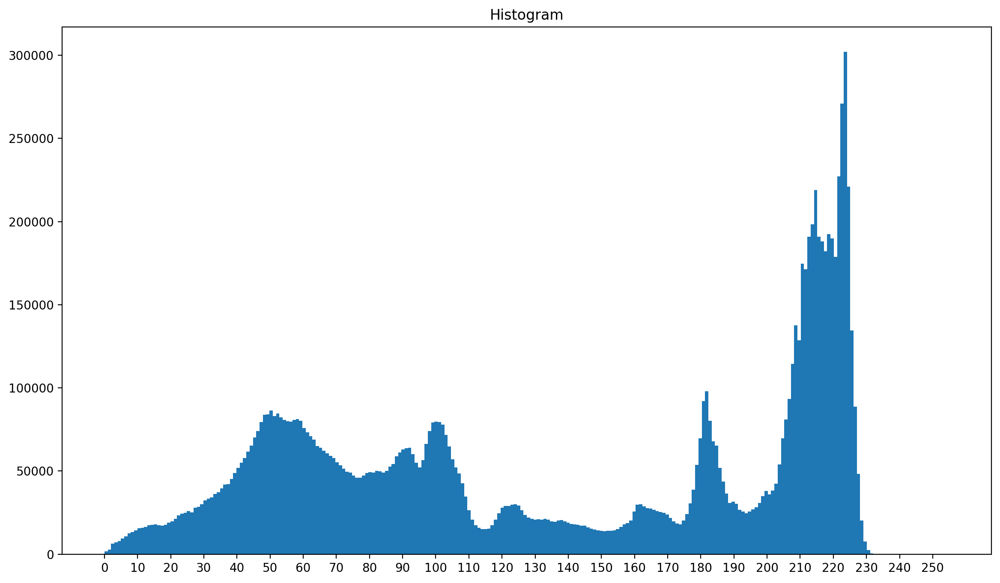

In [36]:
rcParams['figure.figsize'] = 14,8
plt.hist(img_gs.ravel(),256,[0,255])
plt.title('Histogram')
plt.xticks(np.arange(0, 255, 10))
plt.show()

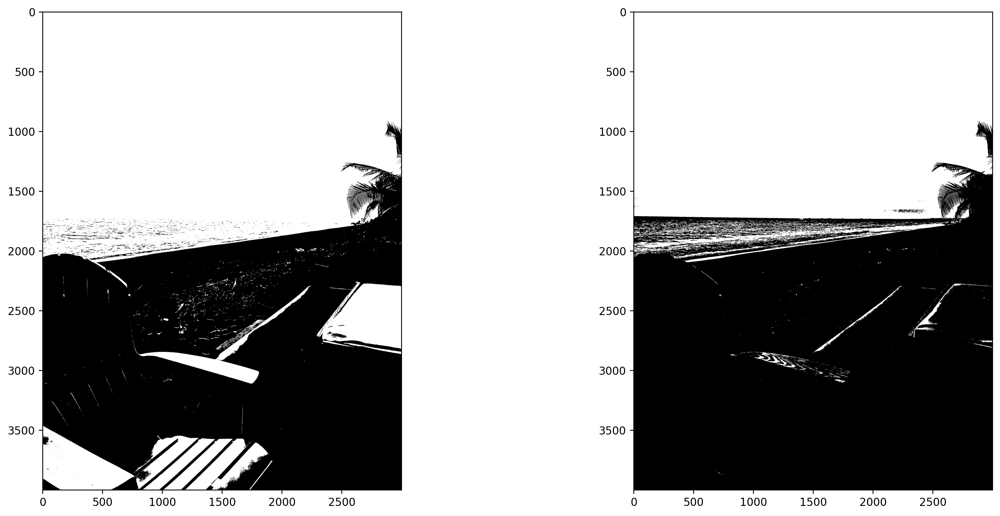

In [37]:
# Task #4: Compare two Black and White Images
#
# Pick two global thresholds from the histogram above and compare  
# the two resulting images. Feel free to use OpenCV.

# Write your code here

img_BW1 = grayscale_to_BW(img_gs,115)
img_BW2 = grayscale_to_BW(img_gs,175)

# figure size in inches
rcParams['figure.figsize'] = 18,8

# display images
fig, ax = plt.subplots(1,2)
ax[0].imshow(img_BW1, cmap='gray')
ax[1].imshow(img_BW2, cmap='gray')
